In [1]:
import numpy as np
import matplotlib.pyplot as plt
from camutils import *
from meshutils import writeply
import pickle
import visutils
import cv2
from scipy.spatial import Delaunay
import matplotlib.patches as patches
from mpl_toolkits.mplot3d import Axes3D
import trimesh

%matplotlib inline

{'fx': 1405.321291016002, 'fy': 1403.9040882554848, 'cx': 962.1638432781476, 'cy': 590.925281441257, 'dist': array([[-5.23616398e-03,  8.06252729e-02,  2.04807988e-05,
        -3.90754589e-03, -1.08137120e-01]])}
Left Camera : 
 f=1404.6126896357434 
 c=[[962.16384328 590.92528144]] 
 R=[[-0.00259819  0.9909686   0.13406892]
 [ 0.99277869 -0.01352313  0.1191956 ]
 [ 0.11993213  0.13341046 -0.98377738]] 
 t = [[ 7.50034872  7.20907135 47.76536762]]
Right Camera : 
 f=1404.6126896357434 
 c=[[962.16384328 590.92528144]] 
 R=[[ 0.03843677  0.98947349  0.13951641]
 [ 0.97735756 -0.00815333 -0.21143728]
 [-0.20807406  0.14448439 -0.96738278]] 
 t = [[ 6.86592186 19.52347986 47.34466469]]


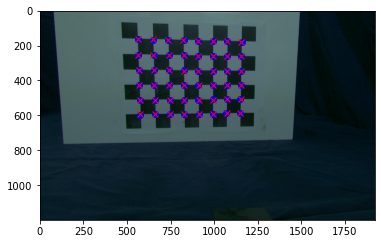

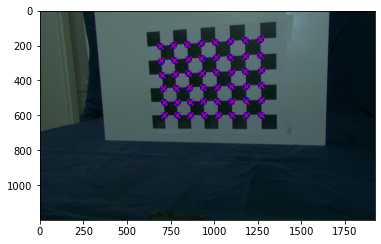

In [2]:
calibFile = open('calibration.pickle', 'rb')
dict = pickle.load(calibFile)
f = (dict['fx']+dict['fy']) * .5
c = np.array([[dict['cx']], [dict['cy']]])
R = makerotation(0,0,0)
t = np.array([[0],[0],[0]])
print(dict)

camL = Camera(f,c,R,t)
camR = Camera(f,c,R,t)

imgL = plt.imread('calib_jpg_u/frame_C1_01.jpg')
_, cornersL = cv2.findChessboardCorners(imgL, (8,6), None)
pts2L = cornersL.squeeze().T

imgR = plt.imread('calib_jpg_u/frame_C0_01.jpg')
_, cornersR = cv2.findChessboardCorners(imgR, (8,6), None)
pts2R = cornersR.squeeze().T

pts3 = np.zeros((3,8*6))
yy,xx = np.meshgrid(np.arange(8),np.arange(6))
pts3[0,:] = 2.8*xx.reshape(1,-1)
pts3[1,:] = 2.8*yy.reshape(1,-1)

params_init_L=np.array([0,0,0,0,0,0]) 
params_init_R=np.array([0,0,0,0,0,0])

camL = calibratePose(pts3,pts2L,camL,params_init_L) 
camR = calibratePose(pts3,pts2R,camR,params_init_R)

print(f"Left {camLin}")
print(f"Right {camR}")
plt.figure()
pts2Lp = camL.project(pts3)
plt.imshow(imgL)
plt.plot(pts2Lp[0,:],pts2Lp[1,:],'bo')
plt.plot(pts2L[0,:],pts2L[1,:],'rx')
plt.show()

plt.figure()
pts2Rp = camR.project(pts3)
plt.imshow(imgR)
plt.plot(pts2Rp[0,:],pts2Rp[1,:],'bo')
plt.plot(pts2R[0,:],pts2R[1,:],'rx')
plt.show()

In [3]:
def reconstructColor(resultfile, objectL, objectR, backgroundL, backgroundR, imprefixL,imprefixR,threshold,thresholdC,camL,camR):

    #decode and create masks for object and background and combine them for left and right cams
    bgL = plt.imread(backgroundL)
    bgR = plt.imread(backgroundR)
    objL = plt.imread(objectL)
    objR = plt.imread(objectR)
    
    cmaskDiffL = np.square(np.abs(objL - bgL))
    cmaskDiffR = np.square(np.abs(objR - bgR))
    cmaskDiffL = cmaskDiffL > thresholdC
    cmaskDiffR = cmaskDiffR > thresholdC
    cmaskDiffL = np.mean(cmaskDiffL, axis=2)
    cmaskDiffR = np.mean(cmaskDiffR, axis=2)
    
    hL, hLmask = decode(imprefixL, 0, threshold)
    vL, vLmask = decode(imprefixL, 20, threshold)
    hR, hRmask = decode(imprefixR, 0, threshold)
    vR, vRmask = decode(imprefixR, 20, threshold)

    cL = hL + 1024*vL
    maskL = hLmask*vLmask*cmaskDiffL
    cR = hR + 1024*vR
    maskR = hRmask*vRmask*cmaskDiffR
    
    # Find the indices of pixels in the left and right code image that 
    # have matching codes. If there are multiple matches, just
    # choose one arbitrarily.
    subR = np.nonzero(maskR.flatten())
    subL = np.nonzero(maskL.flatten())

    _,matchR,matchL = np.intersect1d(cR.flatten()[subR],
                                     cL.flatten()[subL],
                                     return_indices=True)
    matchRfinal = subR[0][matchR]
    matchLfinal = subL[0][matchL]
    
    h,w = cR.shape
    
    # Let CL and CR be the flattened arrays of codes for the left and right view
    # Suppose you have computed arrays of indices matchL and matchR so that 
    # CL[matchL[i]] == CR[matchR[i]] for all i.  The code below gives one approach
    # to generating the corresponding pixel coordinates for the matched pixels
    
    xx,yy = np.meshgrid(range(w),range(h))
    xx = np.reshape(xx,(-1,1))
    yy = np.reshape(yy,(-1,1))
    pts2R = np.concatenate((xx[matchRfinal].T,yy[matchRfinal].T),axis=0)
    pts2L = np.concatenate((xx[matchLfinal].T,yy[matchLfinal].T),axis=0)
    
    # Now triangulate the points
    pts3 = triangulate(pts2L, camL, pts2R, camR)
    
    #save pixel colors
    colorL = objL[pts2L[1],pts2L[0]].T
    colorR = objR[pts2R[1],pts2R[0]].T
    color = (colorL+colorR) * 0.5
    
    #save to pickle    
    resultPickle = {}
    resultPickle["color"] = color
    resultPickle["pts2L"] = pts2L
    resultPickle["pts2R"] = pts2R
    resultPickle["pts3"] = pts3
    fid = open(resultfile, "wb")
    pickle.dump(resultPickle, fid)
    fid.close()

In [4]:
def meshGen(resultfile, pts3, pts2l, pts2r, boxlimits, trithresh, colors):
    # Specify limits along the x,y and z axis of a box containing the object
    # we will prune out triangulated points outside these limits
    boxlimits = boxlimits

    # Specify a longest allowed edge that can appear in the mesh. Remove triangles
    # from the final mesh that have edges longer than this value
    threshtri = trithresh

    #
    # bounding box pruning
    #
    pts_good = np.nonzero((pts3[0,:]>boxlimits[0]) & (pts3[0,:] < boxlimits[1]) & 
                          (pts3[1,:]>boxlimits[2]) & (pts3[1,:] < boxlimits[3]) & 
                          (pts3[2,:]>boxlimits[4]) & (pts3[2,:] < boxlimits[5]))
    pts3 = pts3[:, pts_good[0]]
    pts2l = pts2l[:, pts_good[0]]
    pts2r = pts2r[:, pts_good[0]]
    colors = colors[:, pts_good[0]]
    #
    # triangulate the 2D points to get the surface mesh
    #
    tris = Delaunay(pts2l.T)
    tri = tris.simplices

    #
    # triangle pruning
    #
    distAB = np.sqrt(np.sum(np.power(pts3[:, tri[:,0]] - pts3[:, tri[:,1]], 2), axis=0))
    distAC = np.sqrt(np.sum(np.power(pts3[:, tri[:,0]] - pts3[:, tri[:,2]], 2), axis=0))
    distBC = np.sqrt(np.sum(np.power(pts3[:, tri[:,1]] - pts3[:, tri[:,2]], 2), axis=0))
    
    # remove any points which are not refenced in any triangle
    tri_good = (distAB < threshtri) & (distAC < threshtri) & (distBC < threshtri)
    tri = tri[tri_good, :]
    
    keep = np.unique(tri)
    map = np.zeros(pts3.shape[1])
    pts3 = pts3[:,keep]
    pts2l = pts2l[:,keep]
    pts2r = pts2r[:,keep]
    colors = colors[:,keep]
    map[keep] = np.arange(0,keep.shape[0])
    tri = map[tri]
    
    #smooth mesh after pruning
    def find_neighbors(npts, tri):
        nlist = []
        for i in range(npts):
            nlist.append([])
        print("finding neighbors...")
        for i in range(tri.shape[0]):
            nlist[int(tri[i][0])].append(int(tri[i][1]))
            nlist[int(tri[i][0])].append(int(tri[i][2]))
            nlist[int(tri[i][1])].append(int(tri[i][0]))
            nlist[int(tri[i][1])].append(int(tri[i][2]))
            nlist[int(tri[i][2])].append(int(tri[i][0]))
            nlist[int(tri[i][2])].append(int(tri[i][1]))
        return nlist

    neighbors = find_neighbors(pts3.shape[1], tri)
    print("smooothing...")
    for i in range(6):
        for x in range(pts3.shape[1]):
            pts3[:,x] = np.mean(pts3[:,neighbors[x]], axis=1)

    resultPickle = {}
    resultPickle["pts3"] = pts3
    resultPickle["pts2L"] = pts2l
    resultPickle["pts2R"] = pts2r
    resultPickle["tri"] = tri
    resultPickle["colors"] = colors
    fid = open(resultfile, "wb")
    pickle.dump(resultPickle, fid)
    fid.close()

In [5]:
#reconstuction
root = "/Users/MatthewWayneAyres/Documents/UCI School Work/Spring 2021/CS 117/finalproject/couple/"

thresh, threshC = 0.002, 0.01

for i in range(7):
    backgroundL, backgroundR = f"{root}grab_{i}_u/color_C1_00.png", f"{root}grab_{i}_u/color_C0_00.png"
    objectL, objectR =  f"{root}grab_{i}_u/color_C1_01.png", f"{root}grab_{i}_u/color_C0_01.png"
    prefixL, prefixR =  f"{root}grab_{i}_u/frame_C1_", f"{root}grab_{i}_u/frame_C0_"
    resultfile = f"recon{i}.pickle"
    reconstructColor(resultfile,objectL, objectR, backgroundL, backgroundR, prefixL, prefixR, thresh, threshC, camL, camR)
    print(f"done {i}")

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

done 0
loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

done 1
loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10 11 )( 12 13 )( 14 15 )( 16 17 )( 18 19 )

loading( 20 21 )( 22 23 )( 24 25 )( 26 27 )( 28 29 )( 30 31 )( 32 33 )( 34 35 )( 36 37 )( 38 39 )

loading( 0 1 )( 2 3 )( 4 5 )( 6 7 )( 8 9 )( 10

In [ ]:
#individual mesh testing for finding best boxlimits and threshtri

In [6]:
#mesh gen set 0
threshtri = 2
boxlimits = np.array([-15,30,0,21,-30,0])
reconData = open(f"recon0.pickle","rb")
dict = pickle.load(reconData)
resultfile = f"mesh0.pickle"
meshGen(resultfile, dict["pts3"], dict["pts2L"], dict["pts2R"], boxlimits, threshtri, dict["color"])
print(f"done")

getting neighbors...
smooothing...
done


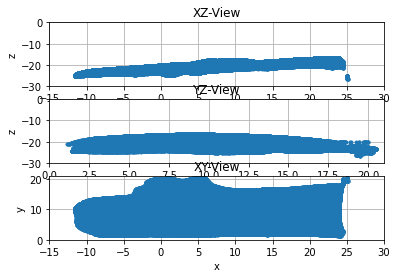

In [7]:
#mesh gen set 0
meshData = open(f"mesh0.pickle","rb")
dict = pickle.load(meshData)
pts3 = dict["pts3"]
tri = dict["tri"]

fig = plt.figure()
ax = fig.add_subplot(3,1,1)
ax.plot(pts3[0,:],pts3[2,:],'.')
plt.axis([-15,30,-30,0])
plt.title('XZ-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('z')

ax = fig.add_subplot(3,1,2)
ax.plot(pts3[1,:],pts3[2,:],'.')
plt.axis([0,21,-30,0])
plt.title('YZ-View')
plt.grid()
plt.xlabel('y')
plt.ylabel('z')

ax = fig.add_subplot(3,1,3)
ax.plot(pts3[0,:],pts3[1,:],'.')
plt.axis([-15,30,0,21])
plt.title('XY-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('y')

plt.show()
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

In [8]:
#mesh gen set 1
threshtri = 5.8
boxlimits = np.array([-15,30,0,17,-30,0])
reconData = open(f"recon1.pickle","rb")
dict = pickle.load(reconData)
resultfile = f"mesh1.pickle"
meshGen(resultfile, dict["pts3"], dict["pts2L"], dict["pts2R"], boxlimits, threshtri, dict["color"])
print(f"done")

getting neighbors...
smooothing...
done


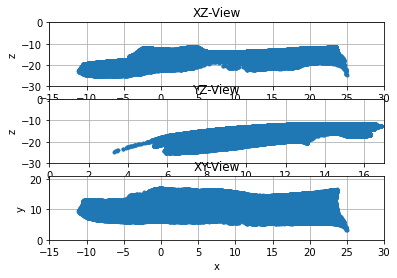

In [9]:
#mesh gen set 1
meshData = open(f"mesh1.pickle","rb")
dict = pickle.load(meshData)
pts3 = dict["pts3"]
tri = dict["tri"]

fig = plt.figure()
ax = fig.add_subplot(3,1,1)
ax.plot(pts3[0,:],pts3[2,:],'.')
plt.axis([-15,30,-30,0])
plt.title('XZ-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('z')

ax = fig.add_subplot(3,1,2)
ax.plot(pts3[1,:],pts3[2,:],'.')
plt.axis([0,17,-30,0])
plt.title('YZ-View')
plt.grid()
plt.xlabel('y')
plt.ylabel('z')

ax = fig.add_subplot(3,1,3)
ax.plot(pts3[0,:],pts3[1,:],'.')
plt.axis([-15,30,0,21])
plt.title('XY-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('y')

plt.show()
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

In [10]:
#mesh gen set 2
threshtri = 3.5
boxlimits = np.array([-12,30,5,20,-30,0])
reconData = open(f"recon2.pickle","rb")
dict = pickle.load(reconData)
resultfile = f"mesh2.pickle"
meshGen(resultfile, dict["pts3"], dict["pts2L"], dict["pts2R"], boxlimits, threshtri, dict["color"])
print(f"done")

getting neighbors...
smooothing...
done


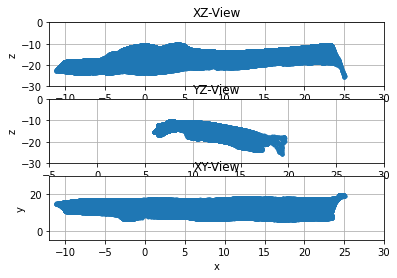

In [11]:
#mesh gen set 2
meshData = open(f"mesh2.pickle","rb")
dict = pickle.load(meshData)
pts3 = dict["pts3"]
tri = dict["tri"]

fig = plt.figure()
ax = fig.add_subplot(3,1,1)
ax.plot(pts3[0,:],pts3[2,:],'.')
plt.axis([-12,30,-30,0])
plt.title('XZ-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('z')

ax = fig.add_subplot(3,1,2)
ax.plot(pts3[1,:],pts3[2,:],'.')
plt.axis([-5,30,-30,0])
plt.title('YZ-View')
plt.grid()
plt.xlabel('y')
plt.ylabel('z')

ax = fig.add_subplot(3,1,3)
ax.plot(pts3[0,:],pts3[1,:],'.')
plt.axis([-12,30,-5,30])
plt.title('XY-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('y')

plt.show()
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

In [12]:
#mesh gen set 3
threshtri = 2
boxlimits = np.array([-12,30,-5,20,-30,0])
reconData = open(f"recon3.pickle","rb")
dict = pickle.load(reconData)
resultfile = f"mesh3.pickle"
meshGen(resultfile, dict["pts3"], dict["pts2L"], dict["pts2R"], boxlimits, threshtri, dict["color"])
print(f"done")

getting neighbors...
smooothing...
done


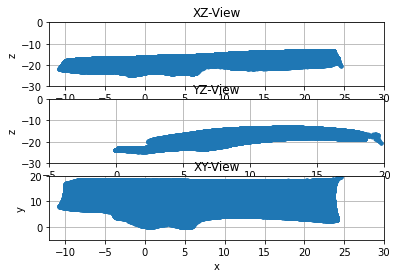

In [13]:
#mesh gen set 3
meshData = open(f"mesh3.pickle","rb")
dict = pickle.load(meshData)
pts3 = dict["pts3"]
tri = dict["tri"]

fig = plt.figure()
ax = fig.add_subplot(3,1,1)
ax.plot(pts3[0,:],pts3[2,:],'.')
plt.axis([-12,30,-30,0])
plt.title('XZ-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('z')

ax = fig.add_subplot(3,1,2)
ax.plot(pts3[1,:],pts3[2,:],'.')
plt.axis([-5,20,-30,0])
plt.title('YZ-View')
plt.grid()
plt.xlabel('y')
plt.ylabel('z')

ax = fig.add_subplot(3,1,3)
ax.plot(pts3[0,:],pts3[1,:],'.')
plt.axis([-12,30,-5,20])
plt.title('XY-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('y')

plt.show()
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

In [14]:
#mesh gen set 4
threshtri = 5
boxlimits = np.array([-10,30,5,18.5,-22,0])
reconData = open(f"recon4.pickle","rb")
dict = pickle.load(reconData)
resultfile = f"mesh4.pickle"
meshGen(resultfile, dict["pts3"], dict["pts2L"], dict["pts2R"], boxlimits, threshtri, dict["color"])
print(f"done")

getting neighbors...
smooothing...
done


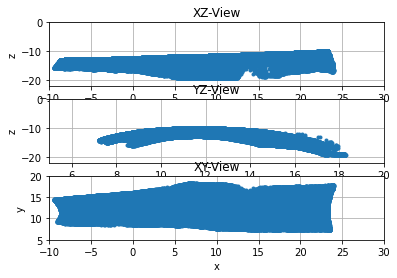

In [15]:
#mesh gen set 4
meshData = open(f"mesh4.pickle","rb")
dict = pickle.load(meshData)
pts3 = dict["pts3"]
tri = dict["tri"]

fig = plt.figure()
ax = fig.add_subplot(3,1,1)
ax.plot(pts3[0,:],pts3[2,:],'.')
plt.axis([-10,30,-22,0])
plt.title('XZ-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('z')

ax = fig.add_subplot(3,1,2)
ax.plot(pts3[1,:],pts3[2,:],'.')
plt.axis([5,20,-22,0])
plt.title('YZ-View')
plt.grid()
plt.xlabel('y')
plt.ylabel('z')

ax = fig.add_subplot(3,1,3)
ax.plot(pts3[0,:],pts3[1,:],'.')
plt.axis([-10,30,5,20])
plt.title('XY-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('y')

plt.show()
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

In [16]:
#mesh gen set 5
threshtri = 4.5
boxlimits = np.array([-15,25,-5,25,-40,0])
reconData = open(f"recon5.pickle","rb")
dict = pickle.load(reconData)
resultfile = f"mesh5.pickle"
meshGen(resultfile, dict["pts3"], dict["pts2L"], dict["pts2R"], boxlimits, threshtri, dict["color"])
print(f"done")

getting neighbors...
smooothing...
done


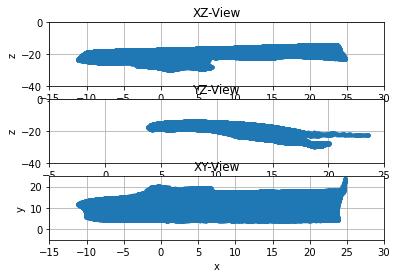

In [17]:
#mesh gen set 5
meshData = open(f"mesh5.pickle","rb")
dict = pickle.load(meshData)
pts3 = dict["pts3"]
tri = dict["tri"]

fig = plt.figure()
ax = fig.add_subplot(3,1,1)
ax.plot(pts3[0,:],pts3[2,:],'.')
plt.axis([-15,30,-40,0])
plt.title('XZ-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('z')

ax = fig.add_subplot(3,1,2)
ax.plot(pts3[1,:],pts3[2,:],'.')
plt.axis([-5,25,-40,0])
plt.title('YZ-View')
plt.grid()
plt.xlabel('y')
plt.ylabel('z')

ax = fig.add_subplot(3,1,3)
ax.plot(pts3[0,:],pts3[1,:],'.')
plt.axis([-15,30,-5,25])
plt.title('XY-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('y')

plt.show()
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

In [18]:
#mesh gen set 6
threshtri = 8
boxlimits = np.array([10,23,-30,30,-40,0])
reconData = open(f"recon6.pickle","rb")
dict = pickle.load(reconData)
resultfile = f"mesh6.pickle"
meshGen(resultfile, dict["pts3"], dict["pts2L"], dict["pts2R"], boxlimits, threshtri, dict["color"])
print(f"done")

getting neighbors...
smooothing...
done


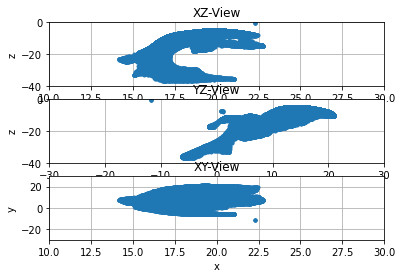

In [19]:
#mesh gen set 6
meshData = open(f"mesh6.pickle","rb")
dict = pickle.load(meshData)
pts3 = dict["pts3"]
tri = dict["tri"]

fig = plt.figure()
ax = fig.add_subplot(3,1,1)
ax.plot(pts3[0,:],pts3[2,:],'.')
plt.axis([10,30,-40,0])
plt.title('XZ-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('z')

ax = fig.add_subplot(3,1,2)
ax.plot(pts3[1,:],pts3[2,:],'.')
plt.axis([-30,30,-40,0])
plt.title('YZ-View')
plt.grid()
plt.xlabel('y')
plt.ylabel('z')

ax = fig.add_subplot(3,1,3)
ax.plot(pts3[0,:],pts3[1,:],'.')
plt.axis([10,30,-30,30])
plt.title('XY-View')
plt.grid()
plt.xlabel('x')
plt.ylabel('y')

plt.show()
mesh = trimesh.Trimesh(vertices=pts3.T,faces=tri[:,[0,2,1]])
mesh.show()

In [20]:
#write final forms to ply
for i in range(7):
    meshData = open(f"mesh{i}.pickle","rb")
    dict = pickle.load(meshData)
    writeply(dict["pts3"], dict["colors"], dict["tri"], f"set{i}.ply")